In [1]:
from collections import defaultdict
import itertools
import os
from pathlib import Path
import time

import IPython.display

%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

import numpy as np
import tensorflow as tf
import tensorflow.keras as keras
import tensorflow_addons as tfa
import math

2022-08-03 19:48:41.880744: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


In [2]:
def dataset_dir():
    return os.path.join(os.curdir, "jsb_chorales")

def train_set_filepaths():
    base_path = os.path.join(dataset_dir(), "train")
    return [os.path.join(base_path, f) for f in os.listdir(base_path)]

def val_set_filepaths():
    base_path = os.path.join(dataset_dir(), "valid")
    return [os.path.join(base_path, f) for f in os.listdir(base_path)]

def test_set_filepaths():
    base_path = os.path.join(dataset_dir(), "test")
    return [os.path.join(base_path, f) for f in os.listdir(base_path)]

In [3]:
class CustomTensorBoard(keras.callbacks.TensorBoard):
    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}
        logs.update({"learning_rate": self.model.optimizer.learning_rate})
        logs.update({"beta_1": self.model.optimizer.beta_1})
        for name, norm in self.model.optimizer.norms.items():
            logs.update({f"gradient_norm_{name}": norm.result()})
            norm.reset_state()
        super().on_epoch_end(epoch, logs)

In [4]:
def base_log_dir():
    return os.path.join(os.curdir, ".tflogs", "bach_chorales")

def get_tensorboard_cb(callback=keras.callbacks.TensorBoard):
    base_dir = base_log_dir()
    run_id = time.strftime("run_%Y_%m_%d_%H_%M_%S")
    run_dir = os.path.join(base_dir, run_id)
    return callback(run_dir)

In [5]:
@tf.function
def inspect(*values):
    print(values)
    return values

class WindowedCSV:
    def __init__(self, window_size=33, shift=16):
        self.window_size = window_size
        self.shift = shift
    
    @tf.function
    def __call__(self, filepath):
        return tf.data.experimental.CsvDataset(filepath, [tf.int32]*4, header=True) \
            .map(lambda *values: tf.stack(values)) \
            .window(self.window_size, shift=self.shift, drop_remainder=True) \
            .flat_map(lambda window: window.batch(self.window_size))
    

def preprocess_multioutput(X):
    return (X[:, :-1], (X[:, 1:, 0], X[:, 1:, 1], X[:, 1:, 2], X[:, 1:, 3]))


class Preprocess:
    def __init__(self, min_note):
        self.min_note = min_note
   
    @tf.function
    def __call__(self, X):
        X = tf.where(X == 0, X, X - self.min_note + 1)
        return tf.reshape(X, (-1,))

def windowed_dataset(filepaths, window_size=33, shift=16):
    dataset = tf.data.Dataset.list_files(filepaths) \
        .flat_map(WindowedCSV(window_size=window_size, shift=shift))
    
    return dataset

@tf.function
def split(X):
    return X[:, :-1], X[:, 1:]
    
    
def preprocessed_dataset(dataset, min_note, shuffle_buffer_size=10000, batch_size=32):
    return dataset \
        .map(Preprocess(min_note)) \
        .shuffle(shuffle_buffer_size) \
        .batch(batch_size, drop_remainder=True) \
        .map(split) \
        .prefetch(1)

In [6]:
# copied from https://github.com/ageron/handson-ml2/blob/master/15_processing_sequences_using_rnns_and_cnns.ipynb
train_set_temp = windowed_dataset(train_set_filepaths(), window_size=100, shift=100)
val_set_temp = windowed_dataset(val_set_filepaths(), window_size=100, shift=100)
test_set_temp = windowed_dataset(test_set_filepaths(), window_size=100, shift=100)

notes = set()
for chorales in (train_set_temp, val_set_temp, test_set_temp):
    for chorale in chorales:
        for chord in chorale:
            notes |= set(chord.numpy())

n_notes = len(notes)
min_note = min(notes - {0})
max_note = max(notes)

assert min_note == 36
assert max_note == 81

2022-08-03 19:48:43.207784: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-08-03 19:48:43.687588: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1532] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 22307 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:68:00.0, compute capability: 8.6


In [7]:
train_set = windowed_dataset(train_set_filepaths())
val_set = windowed_dataset(val_set_filepaths())
test_set = windowed_dataset(test_set_filepaths())

preprocessed_train_set = preprocessed_dataset(train_set, min_note)
preprocessed_val_set = preprocessed_dataset(val_set, min_note)
preprocessed_test_set = preprocessed_dataset(test_set, min_note)

In [8]:
for val in preprocessed_train_set.take(1):
    print(val)

(<tf.Tensor: shape=(32, 131), dtype=int32, numpy=
array([[44, 28, 23, ..., 39, 30, 23],
       [36, 31, 19, ..., 34, 29, 26],
       [36, 34, 31, ..., 34, 25, 19],
       ...,
       [39, 33, 24, ..., 31, 29, 25],
       [32, 29, 22, ..., 32, 29, 22],
       [34, 30, 25, ..., 35, 27, 20]], dtype=int32)>, <tf.Tensor: shape=(32, 131), dtype=int32, numpy=
array([[28, 23, 16, ..., 30, 23, 23],
       [31, 19, 16, ..., 29, 26, 10],
       [34, 31, 12, ..., 25, 19, 16],
       ...,
       [33, 24, 17, ..., 29, 25, 10],
       [29, 22, 15, ..., 29, 22, 14],
       [30, 25, 13, ..., 27, 20, 11]], dtype=int32)>)


In [9]:
def key_to_frequency(notes):
    return 2**((notes - 69)/12.) * 440

def notes_to_audio(notes, framerate):
    frequencies = key_to_frequency(notes)
    note_duration = 1/4.
    frequencies = np.round(frequencies * note_duration) / note_duration
    t = np.linspace(0, note_duration, framerate // 4)
    return np.vstack(list(
        np.hstack(list(np.sin(2*np.pi*f*t) for f in row))
        for row in frequencies.T
    ))

In [10]:
framerate = 44100
# 
# for notes_window in train_set.unbatch().take(10):
#     song = notes_to_audio(notes_window.numpy(), framerate)
#     IPython.display.display(IPython.display.Audio(song, rate=framerate))

In [11]:
def preprocess_input(X):
    X_one_hot = tf.one_hot(X[:, :-1], n_notes)
    return tf.reduce_sum(X_one_hot, axis=-2)

def build_multioutput_model(n_neurons=256, learning_rate=1e-3, compile=True, optimizer=keras.optimizers.Adam, clipnorm=None, dropout=0.0):
    input = keras.layers.Input((None, 4), dtype=tf.int32)
    embedding_dim = 22
    base_model = keras.models.Sequential([
        keras.layers.Embedding(n_notes, embedding_dim),
        keras.layers.Conv1D(4*embedding_dim, 4, strides=1, padding="valid"),
        # keras.layers.Lambda(lambda X: tf.squeeze(X)),
        keras.layers.Reshape((-1, 4*embedding_dim)),
        keras.layers.Lambda(inspect),
        keras.layers.Conv1D(32, kernel_size=2, padding="causal", activation="relu"),
        keras.layers.BatchNormalization(),
        keras.layers.Conv1D(48, kernel_size=2, padding="causal", activation="relu", dilation_rate=2),
        keras.layers.BatchNormalization(),
        keras.layers.Conv1D(64, kernel_size=2, padding="causal", activation="relu", dilation_rate=4),
        keras.layers.BatchNormalization(),
        keras.layers.Conv1D(96, kernel_size=2, padding="causal", activation="relu", dilation_rate=8),
        keras.layers.BatchNormalization(),
        keras.layers.LSTM(n_neurons, return_sequences=True),
        keras.layers.LSTM(n_neurons, return_sequences=True),
    ])(input)
    
    out_classes = n_notes

    out_1 =  keras.layers.Dense(out_classes, activation="softmax")(base_model)
    out_2 =  keras.layers.Dense(out_classes, activation="softmax")(base_model)
    out_3 =  keras.layers.Dense(out_classes, activation="softmax")(base_model)
    out_4 =  keras.layers.Dense(out_classes, activation="softmax")(base_model)
    
    model = keras.models.Model(input, [out_1, out_2, out_3, out_4])
    
    if compile:
        model.compile(
            loss="sparse_categorical_crossentropy",
            optimizer=optimizer(learning_rate=learning_rate, clipnorm=clipnorm),
            metrics=["accuracy"],
        )
    
    return model

# to try:
# dropout
# decrease number of conv layers
# smaller, fixed filter size
# increase embedding_dim
# add an lstm
# switch to gru
def build_model(n_neurons=256, learning_rate=1e-3, compile=True, optimizer=keras.optimizers.Adam, clipnorm=None, dropout=0.0):
    embedding_dim = 5
    model = keras.models.Sequential([])
    
    model.add(keras.layers.Embedding(n_notes, embedding_dim))
    
    dilation_rates = [2**j for j in range(5)]
    begin_filters = 32
    
    filters = begin_filters
    for dilation_rate in dilation_rates:
        print(filters)
        model.add(keras.layers.Conv1D(filters=filters, kernel_size=2, padding="causal", activation="relu", dilation_rate=dilation_rate))
        model.add(keras.layers.BatchNormalization())
        filters += 16
    
    model.add(keras.layers.LSTM(n_neurons, return_sequences=True, dropout=dropout))
    model.add(keras.layers.Dense(n_notes, activation="softmax"))
    
    if compile:
        model.compile(
            loss="sparse_categorical_crossentropy",
            optimizer=optimizer(learning_rate=learning_rate, clipnorm=clipnorm),
            metrics=["accuracy"],
        )
    return model

In [12]:
class LearningRateCallback(keras.callbacks.Callback):
    def __init__(self, initial_learning_rate, final_learning_rate, steps):
        self.factor = math.exp(math.log(final_learning_rate/float(initial_learning_rate))/steps)
        self.losses = []
        self.learning_rates = []
    
    def on_batch_end(self, batch, logs):
        self.losses.append(logs.get("loss"))
        learning_rate = keras.backend.get_value(self.model.optimizer.learning_rate)
        self.learning_rates.append(learning_rate)
        keras.backend.set_value(self.model.optimizer.learning_rate, learning_rate*self.factor)

def find_best_learning_rate(
    train_set,
    val_set,
    compiled_model, 
    n_steps=500,
    learning_rate_min=1e-5, 
    learning_rate_max=1e-1,
    ):
    keras.backend.clear_session()
    np.random.seed(42)
    tf.random.set_seed(42)  
    
    learning_rate_callback = LearningRateCallback(learning_rate_min, learning_rate_max, n_steps)
    
    history = compiled_model.fit(
      train_set,
      epochs=1,
      steps_per_epoch=n_steps,
      validation_data=val_set,
      callbacks=[learning_rate_callback],
    )
    
    
    learning_rates = np.array(learning_rate_callback.learning_rates)
    losses = np.array(learning_rate_callback.losses)
    idx = losses < 10000
    learning_rates_clean = learning_rates[idx]
    losses_clean = losses[idx]
    
    plt.plot(learning_rates_clean, losses_clean)
    best_idx = np.argmin(losses_clean)
    best_learning_rate = learning_rates[best_idx] / 10.
    return best_learning_rate

In [13]:
def train_model(
    train_set, 
    val_set, 
    name, 
    compiled_model, 
    callbacks=None,
    n_epochs=500,
    steps_per_epoch=None,
    tensorboard_callback=keras.callbacks.TensorBoard,
    ):
    callbacks = callbacks or []
    keras.backend.clear_session()
    np.random.seed(42)
    tf.random.set_seed(42)
    
    builtin_callbacks = [
        keras.callbacks.ModelCheckpoint(f"{name}_model.h5", save_best_only=True),
        keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True),
        get_tensorboard_cb(callback=tensorboard_callback),
    ]
    
    history = compiled_model.fit(
        train_set,
        epochs=n_epochs,
        steps_per_epoch=steps_per_epoch,
        validation_data=val_set,
        callbacks=callbacks + builtin_callbacks,
    )

32
48
64
80
96


2022-08-03 19:49:09.148851: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100
2022-08-03 19:49:09.750202: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2022-08-03 19:49:09.751166: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2022-08-03 19:49:09.751210: W tensorflow/stream_executor/gpu/asm_compiler.cc:80] Couldn't get ptxas version string: INTERNAL: Couldn't invoke ptxas --version
2022-08-03 19:49:09.752278: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2022-08-03 19:49:09.752372: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] INTERNAL: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.
2022-08-03 19:49:10.427439: I tensorflow/stream_executor/cuda/c

500/500 [==============================] - 13s 10ms/step - loss: 3.8091 - accuracy: 0.0542 - val_loss: 3.7577 - val_accuracy: 0.0580


9.120106551563367e-06

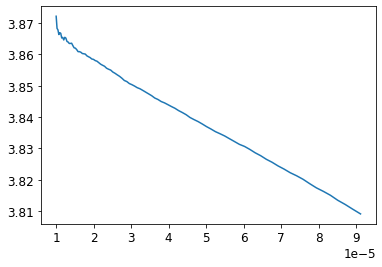

In [14]:
model = build_model(learning_rate=1e-5, optimizer=keras.optimizers.Nadam)
best_learning_rate = find_best_learning_rate(preprocessed_train_set, preprocessed_val_set, model, learning_rate_min=1e-5, learning_rate_max=1e0)
best_learning_rate

In [15]:
model = build_model(learning_rate=1e-3, optimizer=keras.optimizers.Nadam)
train_model(preprocessed_train_set, preprocessed_val_set, "bach_chorales_nadam_conv1d_bn_4_lstm_1_dense_1", model)

32
48
64
80
96
Epoch 1/500
97/97 [==============================] - 11s 53ms/step - loss: 1.8542 - accuracy: 0.5194 - val_loss: 3.7549 - val_accuracy: 0.0339
Epoch 2/500
97/97 [==============================] - 8s 48ms/step - loss: 0.8628 - accuracy: 0.7704 - val_loss: 3.6503 - val_accuracy: 0.1037
Epoch 3/500
97/97 [==============================] - 8s 48ms/step - loss: 0.7173 - accuracy: 0.7986 - val_loss: 3.1502 - val_accuracy: 0.1982
Epoch 4/500
97/97 [==============================] - 8s 48ms/step - loss: 0.6444 - accuracy: 0.8134 - val_loss: 2.5075 - val_accuracy: 0.3122
Epoch 5/500
97/97 [==============================] - 7s 48ms/step - loss: 0.5942 - accuracy: 0.8242 - val_loss: 1.5359 - val_accuracy: 0.5307
Epoch 6/500
97/97 [==============================] - 7s 47ms/step - loss: 0.5546 - accuracy: 0.8335 - val_loss: 0.9027 - val_accuracy: 0.7373
Epoch 7/500
97/97 [==============================] - 8s 47ms/step - loss: 0.5201 - accuracy: 0.8419 - val_loss: 0.6782 - val_accurac

In [16]:
def next_note(X, temperature=1.):
    y_probas = model.predict(X, verbose=0)[:, -1:]
    rescaled_y_probas = tf.math.log(y_probas) / temperature
    y_pred = tf.random.categorical(tf.squeeze(rescaled_y_probas, axis=0), num_samples=1, dtype=tf.int32)
    y_pred_transposed = tf.transpose(y_pred)
    return y_pred_transposed

def generate_song(X, target_length):
    while X.shape[1] < target_length:
        note = next_note(X)
        X = tf.concat((X, note), axis=-1)
    return X

def truncate(X):
    idx = X.shape[1] % 4
    return X[:, :-idx]

def shift(X):
    return tf.where(X == 0, X, X + min_note - 1)

seed_idx = 40
for notes, _ in preprocessed_test_set.unbatch().batch(1).take(3):
    print("song")
    notes = truncate(notes)
    reshaped_notes = tf.reshape(notes[:, :seed_idx], (-1, 4))
    target_song = notes_to_audio(np.squeeze(shift(reshaped_notes).numpy()), framerate)
    IPython.display.display(IPython.display.Audio(target_song, rate=framerate))
    for i in (seed_idx,):
        generated_notes = generate_song(notes[:, :i], 8*seed_idx)
        reshaped_generated_notes = tf.reshape(generated_notes, (-1, 4))
        # print(reshaped_generated_notes[:, :4])
        generated_song = notes_to_audio(np.squeeze(shift(reshaped_generated_notes).numpy()), framerate)
        IPython.display.display(IPython.display.Audio(generated_song, rate=framerate))

song


song


song
